**Date**: 2024-08-27

**Author**: Huaying Qiu, Wenrui Wu

# Preparation

In [1]:
import tifffile 
import numpy as np
import pandas as pd
import re
from pathlib import Path
from typing import List, Dict
import os 
import skimage.io as io
from skimage import img_as_ubyte
from datetime import datetime
from matplotlib import pyplot as plt
import matplotlib.patches as patches
import tensorflow as tf
from deepcell.applications import Mesmer
from deepcell.utils.plot_utils import create_rgb_image, make_outline_overlay


os.environ["CUDA_VISIBLE_DEVICES"]="0" # specify visible gpu(s) 0-3
try:
    tf_gpus = tf.config.list_physical_devices('GPU')
    for gpu in tf_gpus:
        tf.config.experimental.set_memory_growth(gpu, True) # allow memory growth on visible gpu(s)
except:
    pass 

In [14]:
# customed functions
def im_scale_marker(im, marker, marker_list, scale=True):
    im_marker = im[marker_list.index(marker)].copy()
    if scale:
        marker_min = np.min(im_marker)
        marker_max = np.max(im_marker)
        im_marker = (im_marker - marker_min) / (marker_max - marker_min)
    return im_marker

def contour_segmentation(overlay):
    # create RGBA image
    _, height, width, _ = overlay.shape
    im_segmentation = np.zeros((height, width, 4), dtype=np.uint8)  # RGBA image
    im_segmentation[..., [0,1,2]] = 255 # RGB
    im_segmentation[..., 3] = (overlay[0, ..., 0] * 255).astype(np.uint8) # Alpha: transparant when overlay == 0
    return im_segmentation

def rename_invalid_marker(marker: str):
    marker = re.sub(r'[/:]', '_', marker)
    return marker

def img_scale_marker(img: np.ndarray, marker: str, marker_list: List[str], scale: bool=True):
    img_marker = img[marker_list.index(marker)]
    if scale:
        img_marker = (img_marker - img_marker.min()) / (img_marker.max() - img_marker.min())
    return img_marker

def segment_mesmer_core(core_img: np.ndarray, 
                        boundary: List[str], internal: List[str], marker_list: List[str], 
                        scale: bool=True, 
                        maxima_threshold: float=0.075, interior_threshold: float=0.20):
    """
    Perform segmentation on a single core image.
    """
    # Prepare data
    boundary = [rename_invalid_marker(marker) for marker in boundary]
    boundary_list = [img_scale_marker(core_img, marker, marker_list, scale=scale) for marker in boundary]
    boundary_sum = np.sum(boundary_list, axis=0)
    boundary_sum = 255 * (boundary_sum - boundary_sum.min()) / (boundary_sum.max() - boundary_sum.min())
    boundary_sum = boundary_sum.astype("uint8")

    internal = [rename_invalid_marker(marker) for marker in internal]
    internal_list = [img_scale_marker(core_img, marker, marker_list, scale=scale) for marker in internal]
    internal_sum = np.sum(internal_list, axis=0)
    internal_sum = 255 * (internal_sum - internal_sum.min()) / (internal_sum.max() - internal_sum.min())
    internal_sum = internal_sum.astype("uint8")

    seg_stack = np.stack((internal_sum, boundary_sum), axis = -1)
    seg_stack = np.expand_dims(seg_stack, 0)

    # Do whole cell segmentation
    mesmer = Mesmer()
    predictions = mesmer.predict(
        seg_stack, image_mpp = 0.5,
        postprocess_kwargs_whole_cell={
            'maxima_threshold': maxima_threshold,     # larger less cells
            'interior_threshold': interior_threshold  # larger larger cells
        }, 
        compartment = 'nuclear'
    )
    rgb_image = create_rgb_image(seg_stack, channel_colors = ["blue", "green"])
    overlay = make_outline_overlay(rgb_data = rgb_image, predictions = predictions)
    return predictions, rgb_image, overlay

In [7]:
# select parameter ^ #####
path_folder = "/mnt/nfs/home/wenruiwu/projects/Sarcoma/data_raw/20240611_LMS-TMA_Scan1"
# select parameter $ #####

im_name = Path(path_folder).name
path_image = f"{path_folder}/{im_name}.qptiff"
path_marker = f"{path_folder}/{im_name}_MarkerList.txt"
path_metadata = f"{path_folder}/{im_name}_metadata.txt"
path_dearrayer, = [path for path in Path(path_folder).glob("*dearrayer*")]
diameter, = re.findall(r"(?<=d=)[.0-9]+(?=[.]txt)", path_dearrayer.name)
diameter = float(diameter)

print(f"{path_image}\n{path_marker}\n{path_metadata}\n{path_dearrayer}\ndiameter = {diameter}")

/mnt/nfs/home/wenruiwu/projects/Sarcoma/data_raw/20240611_LMS-TMA_Scan1/20240611_LMS-TMA_Scan1.qptiff
/mnt/nfs/home/wenruiwu/projects/Sarcoma/data_raw/20240611_LMS-TMA_Scan1/20240611_LMS-TMA_Scan1_MarkerList.txt
/mnt/nfs/home/wenruiwu/projects/Sarcoma/data_raw/20240611_LMS-TMA_Scan1/20240611_LMS-TMA_Scan1_metadata.txt
/mnt/nfs/home/wenruiwu/projects/Sarcoma/data_raw/20240611_LMS-TMA_Scan1/20240611_LMS-TMA_Scan1_dearrayer_d=1.3.txt
diameter = 1.3


# Data Exploration

In [8]:
im_tma = tifffile.imread(path_image)

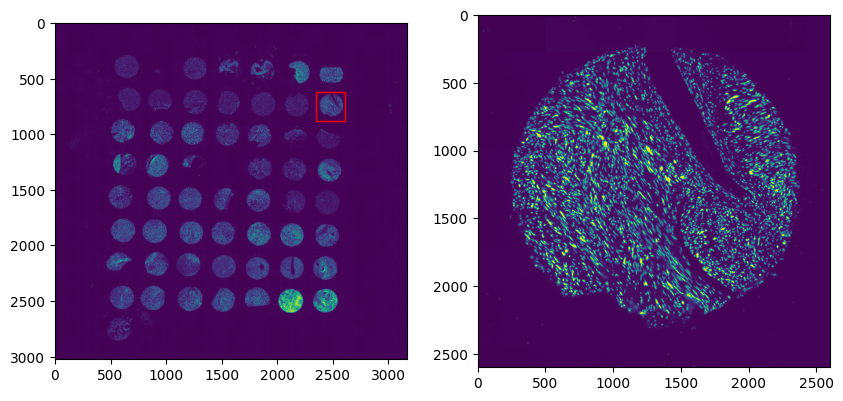

In [9]:
# location of one core ^ #####
y_beg, y_end = 6200, 8800
x_beg, x_end = 23500, 26100
# location of one core $ #####

im_core = im_tma[:, y_beg:y_end, x_beg:x_end]
pixel_step = 10
fig = plt.figure(figsize=(10, 10))
# figure 1
ax = fig.add_subplot(1, 2, 1)
ax.imshow(im_tma[0, ::pixel_step, ::pixel_step])
rect = patches.Rectangle((x_beg/pixel_step, y_beg/pixel_step), 
                         x_end/pixel_step - x_beg/pixel_step, 
                         y_end/pixel_step - y_beg/pixel_step,
                         linewidth=1, edgecolor='red', facecolor='none')
ax.add_patch(rect)
# figure 2
ax = fig.add_subplot(1, 2, 2)
ax.imshow(im_core[0])
plt.show()

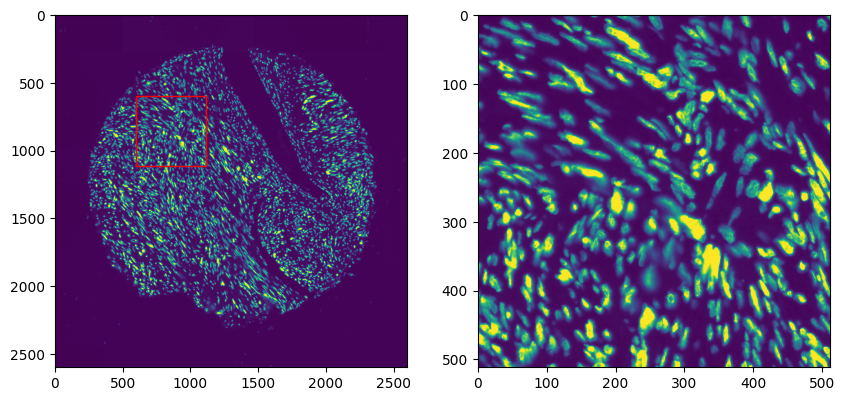

In [10]:
# location of small region within one core ^ #####
x_sub_beg, x_sub_end = 600, 600 + 512
y_sub_beg, y_sub_end = 600, 600 + 512
# location of small region within one core $ #####

im_core_sm = im_core[:, y_sub_beg:y_sub_end, x_sub_beg:x_sub_end]
fig = plt.figure(figsize=(10, 10))
# figure 1
ax = fig.add_subplot(1, 2, 1)
ax.imshow(im_core[0])
rect = patches.Rectangle((x_sub_beg, y_sub_beg), 
                         x_sub_end - x_sub_beg, 
                         y_sub_end - y_sub_beg,
                         linewidth=1, edgecolor='red', facecolor='none')
ax.add_patch(rect)
# figure 2
ax = fig.add_subplot(1, 2, 2)
ax.imshow(im_core_sm[0])
plt.show()

# Segmentation

## Get nuclear and membrane channel

In [11]:
with open(path_marker, 'r') as f:
    marker_list = f.read().splitlines()
marker_list = [rename_invalid_marker(marker) for marker in marker_list if len(marker) > 0]

chunk_size = 10
pd.DataFrame([marker_list[i:i + chunk_size] for i in range(0, len(marker_list), chunk_size)]).fillna("")

,0,1,2,3,4,5,6,7,8,9
0,DAPI,EGFR,CD56,CD16,CD20,CD69,ATP5A,CD57,CD68,Tim-3
1,MPO,CD11c,HLA1,CD3,CD45RA,CD47,CD11b,CS,CD138 (syndecan-1),GLUT1
2,H3K27ac,TCF1_7,α-SMA,FoxP3,Podoplanin,Rb,Desmin,GranzymeB,PTEN,IDO
3,Collagen-IV,Tox_Tox2,CD15,PD-1,CD134,NaKATP,Histone-H3,β-catenin,Vimentin,CD8
4,panCK,LAG-3,CD39,CD4,PD-L1-50,CD31,Tbet,HLA1-50,CD206,HLA-DR
5,Vimentin-50,CD45,PD-L1-100,CD163,HLA1-100,C1Q,Vimentin-100,VDAC1,PD-L1-300,CD45RO
6,HLA1-300,Ki67,Vimentin-300,PDL1,CD3,,,,,


## Test: Scaled signals

In [15]:
# select marker ^ #####
boundary_1 = ['GLUT1', 'NaKATP', 'β-catenin', 'CD45', 'HLA1-300']
boundary_2 = ['CD68', 'CD11c', 'Podoplanin', 'CD15', 'CD8', 'panCK', 'CD31', 'CD206', 'CD163']

internal_1 = ['DAPI']
internal_2 = ['α-SMA', 'Desmin', 'Vimentin']

boundary = boundary_1 + boundary_2
internal = internal_1 + internal_2
# select marker $ #####

# set parameter ^ #####
scale = True
maxima_threshold = 0.075
interior_threshold = 0.20
# set parameter $ #####

im = im_core_sm
print(im.shape)
predictions, rgb_image, overlay = segment_mesmer_core(
    im, 
    boundary, internal, marker_list, 
    scale, maxima_threshold, interior_threshold
)

(65, 512, 512)


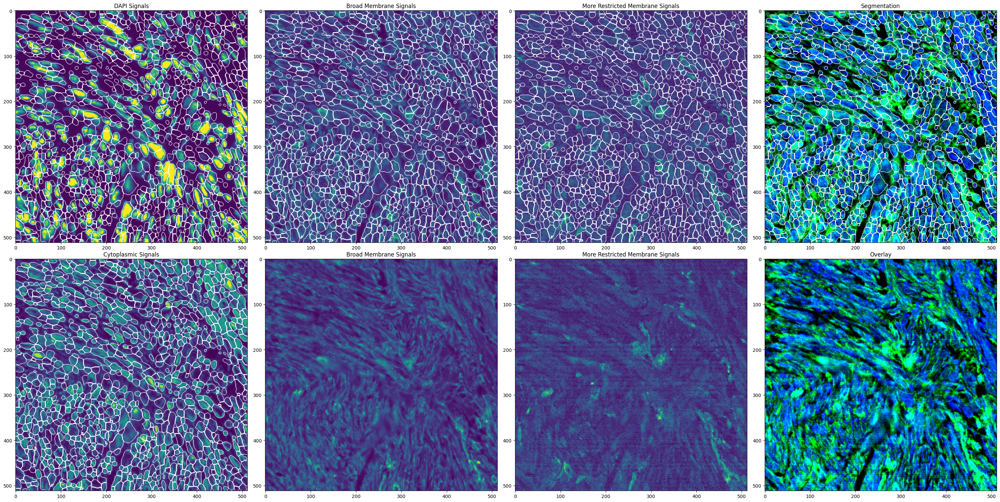

In [16]:
im_segmentation = contour_segmentation(overlay)

fig = plt.figure(figsize = (30,15))
# internal markers
ax = fig.add_subplot(2,4,1)
ax.imshow(np.sum([im_scale_marker(im, marker, marker_list) for marker in internal_1], axis=0))
ax.imshow(im_segmentation, cmap = 'gray')
ax.title.set_text('DAPI Signals')
ax = fig.add_subplot(2,4,5)
ax.imshow(np.sum([im_scale_marker(im, marker, marker_list) for marker in internal_2], axis=0))
ax.imshow(im_segmentation, cmap = 'gray')
ax.title.set_text('Cytoplasmic Signals')
# broad membrane markers
ax = fig.add_subplot(2,4,2)
ax.imshow(np.sum([im_scale_marker(im, marker, marker_list) for marker in boundary_1], axis=0))
ax.imshow(im_segmentation, cmap = 'gray')
ax.title.set_text('Broad Membrane Signals')
ax = fig.add_subplot(2,4,6)
ax.imshow(np.sum([im_scale_marker(im, marker, marker_list) for marker in boundary_1], axis=0))
ax.title.set_text('Broad Membrane Signals')
# more restricted membrane markers
ax = fig.add_subplot(2,4,3)
ax.imshow(np.sum([im_scale_marker(im, marker, marker_list) for marker in boundary_2], axis=0))
ax.imshow(im_segmentation, cmap = 'gray')
ax.title.set_text('More Restricted Membrane Signals')
ax = fig.add_subplot(2,4,7)
ax.imshow(np.sum([im_scale_marker(im, marker, marker_list) for marker in boundary_2], axis=0))
ax.title.set_text('More Restricted Membrane Signals')
# Mesmer
ax = fig.add_subplot(2,4,4)
ax.imshow(overlay[0, ...], cmap = 'gray')
ax.title.set_text('Segmentation')
ax = fig.add_subplot(2,4,8)
ax.imshow(rgb_image[0, ...], cmap = 'gray')
ax.title.set_text('Overlay')

plt.tight_layout()
plt.show()
# !mkdir /mnt/nfs/home/wenruiwu/projects/Sarcoma/data_output/hyperparameter_test/maxima=$maxima_threshold
# plt.savefig(f'/mnt/nfs/home/wenruiwu/projects/Sarcoma/data_output/hyperparameter_test/maxima={maxima_threshold}/maxima={maxima_threshold}-interiro={interior_threshold}.png')
# plt.close()

## Test: Non-Scaled signals

In [17]:
# select marker ^ #####
boundary_1 = ['GLUT1', 'NaKATP', 'β-catenin', 'CD45', 'HLA1-300']
boundary_2 = ['CD68', 'CD11c', 'Podoplanin', 'CD15', 'CD8', 'panCK', 'CD31', 'CD206', 'CD163']

internal_1 = ['DAPI']
internal_2 = ['α-SMA', 'Desmin', 'Vimentin']

boundary = boundary_1 + boundary_2
internal = internal_1 + internal_2
# select marker $ #####

# set parameter ^ #####
scale = False
maxima_threshold = 0.075
interior_threshold = 0.20
# set parameter $ #####

im = im_core_sm
print(im.shape)
predictions, rgb_image, overlay = segment_mesmer_core(
    im, 
    boundary, internal, marker_list, 
    scale, maxima_threshold, interior_threshold
)

(65, 512, 512)


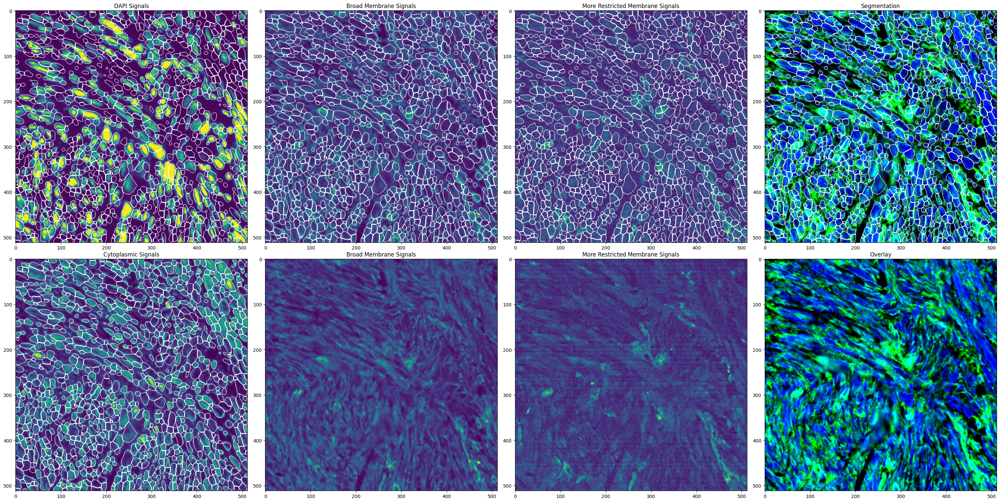

In [18]:
im_segmentation = contour_segmentation(overlay)

fig = plt.figure(figsize = (30,15))
# internal markers
ax = fig.add_subplot(2,4,1)
ax.imshow(np.sum([im_scale_marker(im, marker, marker_list) for marker in internal_1], axis=0))
ax.imshow(im_segmentation, cmap = 'gray')
ax.title.set_text('DAPI Signals')
ax = fig.add_subplot(2,4,5)
ax.imshow(np.sum([im_scale_marker(im, marker, marker_list) for marker in internal_2], axis=0))
ax.imshow(im_segmentation, cmap = 'gray')
ax.title.set_text('Cytoplasmic Signals')
# broad membrane markers
ax = fig.add_subplot(2,4,2)
ax.imshow(np.sum([im_scale_marker(im, marker, marker_list) for marker in boundary_1], axis=0))
ax.imshow(im_segmentation, cmap = 'gray')
ax.title.set_text('Broad Membrane Signals')
ax = fig.add_subplot(2,4,6)
ax.imshow(np.sum([im_scale_marker(im, marker, marker_list) for marker in boundary_1], axis=0))
ax.title.set_text('Broad Membrane Signals')
# more restricted membrane markers
ax = fig.add_subplot(2,4,3)
ax.imshow(np.sum([im_scale_marker(im, marker, marker_list) for marker in boundary_2], axis=0))
ax.imshow(im_segmentation, cmap = 'gray')
ax.title.set_text('More Restricted Membrane Signals')
ax = fig.add_subplot(2,4,7)
ax.imshow(np.sum([im_scale_marker(im, marker, marker_list) for marker in boundary_2], axis=0))
ax.title.set_text('More Restricted Membrane Signals')
# Mesmer
ax = fig.add_subplot(2,4,4)
ax.imshow(overlay[0, ...], cmap = 'gray')
ax.title.set_text('Segmentation')
ax = fig.add_subplot(2,4,8)
ax.imshow(rgb_image[0, ...], cmap = 'gray')
ax.title.set_text('Overlay')

plt.tight_layout()
plt.show()
# !mkdir /mnt/nfs/home/wenruiwu/projects/Sarcoma/data_output/hyperparameter_test/maxima=$maxima_threshold
# plt.savefig(f'/mnt/nfs/home/wenruiwu/projects/Sarcoma/data_output/hyperparameter_test/maxima={maxima_threshold}/maxima={maxima_threshold}-interiro={interior_threshold}.png')
# plt.close()